In [1]:
import numpy as np
import sys
import glob 
import os 
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import scipy.io as sio
from scipy import stats
from natsort import natsorted, ns
import statistics as st
import pickle
import os.path
from os import path

In [2]:
def ModeBaselineZscoreF(F,Fneu, a = 0.7, deg = 5, binSize = 3000):
    
    """Function in order to calculate the baseline of suite2p extracted fluo traces using mode and noise level
    approximation"""
    
    binSize =int(binSize)
    test = F - a*Fneu
    xts = []
    yts = []
    
    
    for tm in range(int(binSize/2),int((len(test)-binSize/2)),int(binSize)):
        xts.append(tm)
        winMode = int(stats.mode(test[int((tm-binSize/2)):int((tm+binSize/2))])[0])
        yts.append(winMode)
        
    p = np.polyfit(np.array(xts),np.array(yts),deg)
    
    bas = np.polyval(p,np.arange(len(test)))
    
    Fsub = test - bas
   
    sigma = np.std(np.concatenate((Fsub[Fsub>np.mean(Fsub)],-1*Fsub[Fsub<np.mean(Fsub)]),axis = 0))
    
    Fbas = Fsub/sigma
        
    return Fbas

In [3]:
def ModeBaselineZscoreSpks(spks, deg = 5, binSize = 3000):
    
    """Function in order to calculate the baseline of suite2p extracted spike traces using mode and noise level
    approximation"""
    
    binSize =int(binSize)
    test = spks
    xts = []
    yts = []
    
    
    for tm in range(int(binSize/2),int((len(test)-binSize/2)),int(binSize)):
        xts.append(tm)
        winMode = int(stats.mode(test[int((tm-binSize/2)):int((tm+binSize/2))])[0])
        yts.append(winMode)
        
    p = np.polyfit(np.array(xts),np.array(yts),deg)
    
    bas = np.polyval(p,np.arange(len(test)))
    
    SpksSub = test - bas
   
    sigma = np.std(np.concatenate((SpksSub[SpksSub>np.mean(SpksSub)],-1*SpksSub[SpksSub<np.mean(SpksSub)]),axis = 0))
    
    SpksBas =  SpksSub/sigma

    return SpksBas

In [5]:
def MeanSigmaCalc(dataCR):
    
    """Calculate the meand and std of the correct rejection vector for zscoring the spiking data"""
    
    CR = dataCR
    CRresh = np.reshape(CR,[CR.shape[0],-1])
    mu = np.mean(CRresh, axis = 1)
    sigma = np.std(CRresh, axis = 1)
    
    return [mu, sigma];
    

In [6]:
def DFFBaselineCalc(dataMatrix,frameStart,frameStop):
    
    """Calculate the DF/F signal based on the baseline window of every trial before stim"""
    
    F = dataMatrix
    FDFF = np.zeros([F.shape[0],F.shape[1],F.shape[2]])
    
    for i in range(F.shape[0]) :
        for j in range(F.shape[2]) :
            Baseline = F[i,frameStart:frameStop,j]
            MeanBaseline = np.mean(Baseline)
            StdBaseline = np.std(Baseline)
            FDFF[i,:,j] = np.divide(F[i,:,j] - MeanBaseline,StdBaseline)
            
    return FDFF 

In [7]:
MiceToAnalyze = ['GF173','GF174','GF175','GF181','GF187','GF193','GF199','GF200','GF201','GF207','GF208']

In [9]:
Order = {
    'GF173' : [],
    'GF174' : [],
    'GF175' : [],
    'GF181' : [3,4,5,0,1,2],
    'GF187' : [],
    'GF193' : [],
    'GF199' : [4,5,0,1,2,3],
    'GF200' : [],
    'GF201' : [],
    'GF207' : [4,5,0,1,2,3],
    'GF208' : [4,5,0,1,2,3]
}

In [10]:
for m, name in enumerate(MiceToAnalyze):
    
    print('Calculating mouse: ' + name )

    mouseName = name
    
    filePath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\' + mouseName + "\\2P\\" + mouseName + '_2P.p'
      
    if path.exists(filePath):
        
        print('This mouse already computed')
        
    else:
        
        nframes = 211

        # Hardcoded paths to the server
        datapath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\DataAll\\' + mouseName + "\\" 
        readingpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\' + mouseName + "\\" 
        serverpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\data\\' + mouseName + '\\Recordings\\Imaging\\'
        behavpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\data\\' + mouseName + '\\Recordings\\BehaviourFiles\\'

        # Detect the operating system to fix the slashes

        if (os.name == "posix"):
            print("Linux or MacOS system detected")

            #Play with the names only important for MacOS

            datapath= datapath.replace('\\','/')
            datapath = '/Volumes/' + datapath[18:] 
            behavpath = behavpath.replace('\\','/')
            behavpath = '/Volumes' + behavpath[18:] 
            serverpath = serverpath.replace('\\','/')
            serverpath = '/Volumes' + serverpath[18:] 

        else:
            print("Windows system detected")

        # Find the imaging days
        imaging_days = glob.glob(os.path.join(behavpath, "GF*"))

        for n,f in enumerate(imaging_days):
            imaging_days[n] = os.path.basename(f)

        # Sort the imaging days by year and month in case the order is not correct
        year = []
        month = []
        for i,f in enumerate(imaging_days):
            year.append(f[-4:])
            month.append(f[-6:-4])

        yearZip = []
        yearZip = natsorted(list(zip(year,imaging_days)))
        year_sorted = [x for y, x in yearZip]


        year = []
        month = []
        for i,f in enumerate(year_sorted):
            year.append(f[-4:])
            month.append(f[-6:-4])


        monthZip = []
        monthZip = natsorted(list(zip(month,year_sorted)))
        month_sorted = [x for y, x in monthZip]


        imaging_days = natsorted(month_sorted)

        if name == 'GF207':

            print('Mouse ' + name + ' big correction needed')

            imaging_days_cor = [imaging_days[0], imaging_days[1], imaging_days[3], imaging_days[5], imaging_days[6],imaging_days[7]] 

            imaging_days = imaging_days_cor

        elif name == 'GF187':

            print('Mouse ' + name + ' big correction needed')

            imaging_days = imaging_days[:-1]


        # Thats a list of dictionaries where all the days for one mouse will be stored
        AllData = []

        DaysLength = np.zeros([1, len(imaging_days)])

        for i,f in enumerate(imaging_days):

            frames_path = serverpath + imaging_days[i] + os.sep + 'TrialFrames.mat'

            print('Loading frames for splitting: ' + frames_path)

            frames = sio.loadmat(frames_path)

            numOfFrames = frames['NumOfFrames']

            numOfFrames = np.array(numOfFrames)

            DaysLength[0,i] = np.sum(numOfFrames)

        #Create the paths to the suite2p files

        F_path = datapath + os.sep + 'suite2p' + os.sep + 'plane0' + os.sep + "F.npy"
        Fneu_path = datapath + os.sep + 'suite2p' + os.sep + 'plane0' + os.sep + "Fneu.npy"
        iscell_path = datapath + os.sep + 'suite2p' + os.sep + 'plane0' + os.sep + "iscell.npy"
        spks_path = datapath  + os.sep + 'suite2p' + os.sep + 'plane0' + os.sep + "spks.npy"

        print('Loading suite2p files ...')

        FAll = np.load(F_path)
        FneuAll = np.load(Fneu_path)
        spksAll = np.load(spks_path)
        iscell = np.load(iscell_path)

        print('Files loaded')

        #Keep only the ROIs detected as cells 

        FAll = FAll[iscell[:,0]==1.]
        FneuAll = FneuAll[iscell[:,0]==1.]
        spksAll = spksAll[iscell[:,0]==1.]


        for d in range(DaysLength.shape[1]):


            F = FAll[:,int(np.sum(DaysLength[0,0:d])):int(np.sum(DaysLength[0,0:(d+1)]))]
            Fneu = FneuAll[:,int(np.sum(DaysLength[0,0:d])):int(np.sum(DaysLength[0,0:(d+1)]))]
            spks = spksAll[:,int(np.sum(DaysLength[0,0:d])):int(np.sum(DaysLength[0,0:(d+1)]))]
            Fbas = np.empty([F.shape[0],F.shape[1]])
            spksbas =  np.empty([spks.shape[0],spks.shape[1]])


            for n in range(Fbas.shape[0]):
                Fbas[n][:] = ModeBaselineZscoreF(F[n,:],Fneu[n,:],0.7,5,3000)
                spksbas[n][:] = ModeBaselineZscoreSpks(spks[n,:],5,3000)


            print('Baselines for F and spks calculated')


            print('Number of Selected ROIs : ' + str(F.shape[0]))

            #Load the behaviour files from the server (.mat files)

            behav_path = behavpath + imaging_days[d] + os.sep + 'BehavResults.mat'

            print('Loading behaviour: ' + behav_path)

            beh = sio.loadmat(behav_path)

            vals = beh['BehavResults'][0,0]

            keys = beh['BehavResults'][0,0].dtype.descr

            beh = np.array(vals[keys[0][0]][:][:])

            #keep the performance column from the behaviour file

            performance = beh[:,9]

            #Load the frames info from the server (.mat files)

            frames_path = serverpath + imaging_days[d] + os.sep + 'TrialFrames.mat'

            print('Loading frame info for trial splitting: ' +  frames_path)

            frames = sio.loadmat(frames_path)

            numOfFrames = frames['NumOfFrames']

            numOfFrames = np.array(numOfFrames)

            # Create an empty dict from every day to store the data

            daysDict = dict.fromkeys(['mousename','dayName','WM','AM','WH','AH','CR','FA','muCRspks','sigmaCRspks'])


            #Create an empty dict from every trial type and measure of suite2p 

            dataDictWM = dict.fromkeys(['WMF','WMFneu','WMFbas','WMspks','WMspksbas', 'WMDFF'])
            dataDictWH = dict.fromkeys(['WHF','WHFneu','WHFbas','WHspks','WHspksbas', 'WHDFF'])
            dataDictAH = dict.fromkeys(['AHF','AHFneu','AHFbas','AHspks','AHspksbas', 'AHDFF'])
            dataDictAM = dict.fromkeys(['AMF','AMFneu','AMFbas','AMspks','AMspksbas', 'AMDFF'])
            dataDictFA = dict.fromkeys(['FAF','FAFneu','FAFbas','FAspks','FAspksbas', 'FADFF'])
            dataDictCR = dict.fromkeys(['CRF','CRFneu','CRFbas','CRspks','CRspksbas', 'CRDFF'])

            #Trial type counters all set to zero

            WMc = 0;
            AMc = 0;
            WHc = 0;
            AHc = 0;
            CRc = 0;
            FAc = 0;

            # Initalise the data core structure as an numpy array or dimensions cells x frames x trials for every trial type 


            WMF = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])
            WMFneu = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])
            WMFbas = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])
            WMspks = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])
            WMspksbas = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])
            WMDFF = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])

            AMF = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])
            AMFneu = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])
            AMFbas = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])
            AMspks = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])
            AMspksbas = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])
            AMDFF = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])


            WHF = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])
            WHFneu = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])
            WHFbas = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])
            WHspks = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])
            WHspksbas = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])
            WHDFF = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])

            AHF = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])
            AHFneu = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])
            AHFbas = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])
            AHspks = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])
            AHspksbas = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])
            AHDFF = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])


            CRF = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])
            CRFneu = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])
            CRFbas = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])
            CRspks = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])
            CRspksbas = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])
            CRDFF = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])

            FAF = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])
            FAFneu = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])
            FAFbas = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])
            FAspks = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])
            FAspksbas = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])
            FADFF = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])


            for t in range(len(performance)):

                #Check the performance outcome using the frame info read the num of frames from the long suite2p vector

                if performance[t] == 0.0:
                    WMF[:,:,WMc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    WMFneu[:,:,WMc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    WMFbas[:,:,WMc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    WMspks[:,:,WMc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    WMspksbas[:,:,WMc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    WMc += 1 

                elif performance[t] == 1.0:
                    AMF[:,:,AMc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    AMFneu[:,:,AMc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    AMFbas[:,:,AMc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    AMspks[:,:,AMc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    AMspksbas[:,:,AMc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    AMc += 1  

                elif performance[t] == 2.0:
                    WHF[:,:,WHc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    WHFneu[:,:,WHc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    WHFbas[:,:,WHc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    WHspks[:,:,WHc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    WHspksbas[:,:,WHc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    WHc += 1

                elif performance[t] == 3.0:
                    AHF[:,:,AHc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    AHFneu[:,:,AHc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    AHFbas[:,:,AHc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    AHspks[:,:,AHc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    AHspksbas[:,:,AHc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    AHc += 1

                elif performance[t] == 4.0:
                    CRF[:,:,CRc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    CRFneu[:,:,CRc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    CRFbas[:,:,CRc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    CRspks[:,:,CRc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    CRspksbas[:,:,CRc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    CRc += 1

                elif performance[t] == 5.0:
                    FAF[:,:,FAc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    FAFneu[:,:,FAc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    FAFbas[:,:,FAc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    FAspks[:,:,FAc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    FAspksbas[:,:,FAc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
                    FAc += 1 

            #Calculate the DF/F singals based on the baseline window of every trial

            WMDFF = DFFBaselineCalc(WMFbas,0,59)
            WHDFF = DFFBaselineCalc(WHFbas,0,59)
            AMDFF = DFFBaselineCalc(AMFbas,0,59)
            AHDFF = DFFBaselineCalc(AHFbas,0,59)
            CRDFF = DFFBaselineCalc(CRFbas,0,59)
            FADFF = DFFBaselineCalc(FAFbas,0,59)

            print('...DF/F calculated...')

            # Store numpy matrices to the dictionaries for each trial type
            dataDictWM = {'WMF' : WMF ,
                          'WMFneu' : WMFneu,
                          'WMFbas' : WMFbas,
                          'WMspks' : WMspks,
                          'WMspksbas' : WMspksbas,
                          'WMDFF' : WMDFF
            }
            dataDictWH = {'WHF' : WHF ,
                          'WHFneu' : WHFneu,
                          'WHFbas' : WHFbas,
                          'WHspks' : WHspks,
                          'WHspksbas' : WHspksbas,
                          'WHDFF' : WHDFF
            }
            dataDictAM = {'AMF' : AMF ,
                          'AMFneu' : AMFneu,
                          'AMFbas' : AMFbas,
                          'AMspks' : AMspks,
                          'AMspksbas' : AMspks,
                          'AMDFF' : AMDFF
            }
            dataDictAH = {'AHF' : AHF ,
                          'AHFneu' : AHFneu,
                          'AHFbas' : AHFbas,
                          'AHspks' : AHspks,
                          'AHspksbas' : AHspksbas,
                          'AHDFF' : AHDFF
            }
            dataDictCR = {'CRF' : CRF ,
                          'CRFneu' : CRFneu,
                          'CRFbas' : CRFbas,
                          'CRspks' : CRspks,
                          'CRspksbas' : CRspksbas,
                          'CRDFF' : CRDFF
            }
            dataDictFA = {'FAF' : FAF ,
                          'FAFneu' : FAFneu,
                          'FAFbas' : FAFbas,
                          'FAspks' : FAspks,
                          'FAspksbas' : FAspksbas,
                          'FADFF' : FADFF
            }

            [muCRspks, sigmaCRspks] = MeanSigmaCalc(CRspks)

            # Store the small dicts i the big dict of each day together with its name 
            daysDict = { 'mousename' : mouseName,
                         'dayName' : imaging_days[d],
                         'WM' : dataDictWM,
                         'WH' : dataDictWH,
                         'AM' : dataDictAM,
                         'AH' : dataDictAH,
                         'CR' : dataDictCR,
                         'FA' : dataDictFA,
                         'muCRspks' : muCRspks,
                         'sigmaCRspks' : sigmaCRspks
            }
            #Append the big list for all the data for one mouse
            AllData.append(daysDict)

        if Order[name]:

            print('Mouse ' + name + ' corrected for the order of days' )

            AllData_cor = []

            for i,order in enumerate(Order[name]):

                AllData_cor.append(AllData[order])

            AllData = AllData_cor

        savingPath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\' + mouseName + "\\2P\\"

        if not(os.path.exists(savingPath)):
            os.mkdir(savingPath)

        filePath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\' + mouseName + "\\2P\\" + mouseName + '_2P.p'

        print('Saving dictionary for: ' + name )

        with open(filePath, 'wb') as fp:
            pickle.dump(AllData, fp, protocol=pickle.HIGHEST_PROTOCOL)

        print('Dictionary saved for: ' + name )



Calculating mouse: GF173
This mouse already computed
Calculating mouse: GF174
This mouse already computed
Calculating mouse: GF175
This mouse already computed
Calculating mouse: GF181
This mouse already computed
Calculating mouse: GF187
This mouse already computed
Calculating mouse: GF193
This mouse already computed
Calculating mouse: GF199
This mouse already computed
Calculating mouse: GF200
This mouse already computed
Calculating mouse: GF201
This mouse already computed
Calculating mouse: GF207
This mouse already computed
Calculating mouse: GF208
Windows system detected
Loading frames for splitting: \\sv1files.epfl.ch\Petersen-Lab\data\GF208\Recordings\Imaging\GF208_01102019\TrialFrames.mat
Loading frames for splitting: \\sv1files.epfl.ch\Petersen-Lab\data\GF208\Recordings\Imaging\GF208_02102019\TrialFrames.mat
Loading frames for splitting: \\sv1files.epfl.ch\Petersen-Lab\data\GF208\Recordings\Imaging\GF208_03102019\TrialFrames.mat
Loading frames for splitting: \\sv1files.epfl.ch\Pet

In [1]:
    Order = {
        'GF173' : [],
        'GF174' : [],
        'GF175' : [],
        'GF181' : [3,4,5,0,1,2],
        'GF182' : [],
        'GF187' : [],
        'GF193' : [],
        'GF199' : [4,5,0,1,2,3],
        'GF200' : [],
        'GF201' : [],
        'GF207' : [4,5,0,1,2,3]
    }
         

In [14]:
name= 'GF187'
print('Calculating mouse: ' + name )

mouseName = name
nframes = 211

# Hardcoded paths to the server
datapath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\DataAll\\' + mouseName + "\\" 
readingpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\' + mouseName + "\\" 
serverpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\data\\' + mouseName + '\\Recordings\\Imaging\\'
behavpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\data\\' + mouseName + '\\Recordings\\BehaviourFiles\\'

# Detect the operating system to fix the slashes

if (os.name == "posix"):
    print("Linux or MacOS system detected")

    #Play with the names only important for MacOS

    datapath= datapath.replace('\\','/')
    datapath = '/Volumes/' + datapath[18:] 
    behavpath = behavpath.replace('\\','/')
    behavpath = '/Volumes' + behavpath[18:] 
    serverpath = serverpath.replace('\\','/')
    serverpath = '/Volumes' + serverpath[18:] 

else:
    print("Windows system detected")

# Find the imaging days
imaging_days = glob.glob(os.path.join(behavpath, "GF*"))

for n,f in enumerate(imaging_days):
    imaging_days[n] = os.path.basename(f)

# Sort the imaging days by year and month in case the order is not correct
year = []
month = []
for i,f in enumerate(imaging_days):
    year.append(f[-4:])
    month.append(f[-6:-4])

yearZip = []
yearZip = natsorted(list(zip(year,imaging_days)))
year_sorted = [x for y, x in yearZip]


year = []
month = []
for i,f in enumerate(year_sorted):
    year.append(f[-4:])
    month.append(f[-6:-4])


monthZip = []
monthZip = natsorted(list(zip(month,year_sorted)))
month_sorted = [x for y, x in monthZip]


imaging_days = natsorted(month_sorted)

Calculating mouse: GF187
Windows system detected


In [15]:
imaging_days

['GF187_21052019',
 'GF187_22052019',
 'GF187_23052019',
 'GF187_24052019',
 'GF187_27052019',
 'GF187_29052019',
 'GF197_29052019']

In [16]:
imaging_days[:-1]

['GF187_21052019',
 'GF187_22052019',
 'GF187_23052019',
 'GF187_24052019',
 'GF187_27052019',
 'GF187_29052019']

In [13]:
imaging_days

['GF197_29052019',
 'GF187_29052019',
 'GF187_27052019',
 'GF187_24052019',
 'GF187_23052019',
 'GF187_22052019',
 'GF187_21052019']

C:\Users\foustouk\.conda\envs\suite2p\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


<Figure size 2160x1800 with 0 Axes>

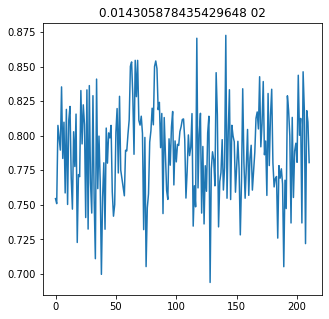

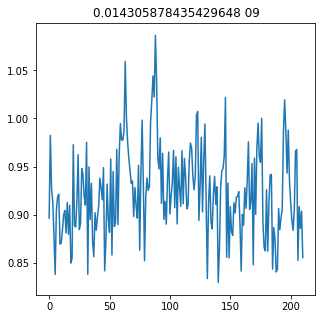

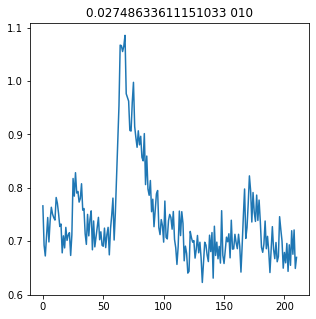

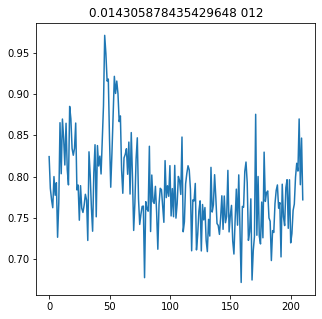

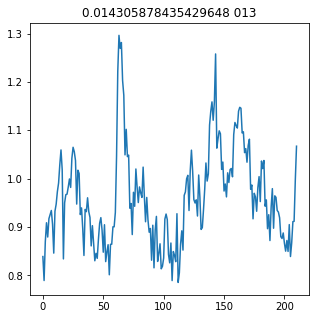

...

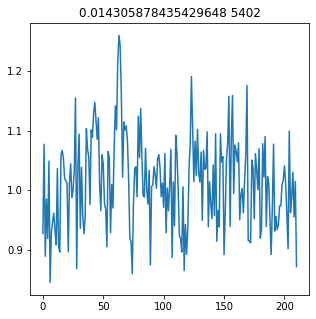

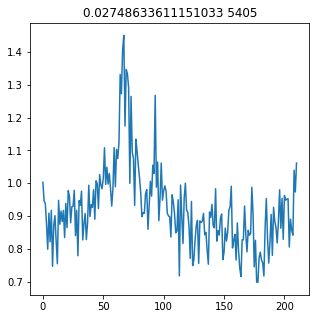

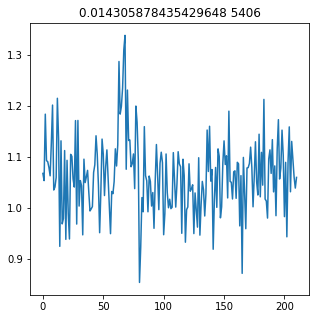

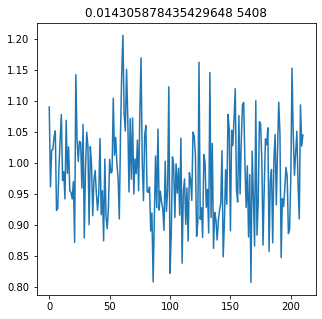

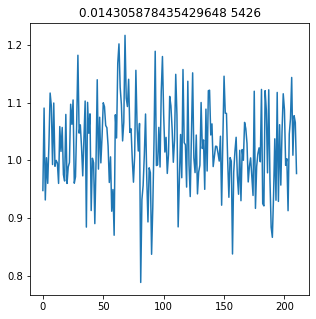

In [73]:
plt.figure(figsize=(30, 25))
CellsSign = np.zeros([1,6])
CellIndexes = [];
for d in range(6):
    cC = 0
    dayData = AllData[d]['WM']['WMFbas']
    meanTrials = np.mean(dayData,axis = 2)
    CellsIdx = [];
    for i in range(meanTrials.shape[0]):
        dataZscore = (meanTrials[i])
        base = dataZscore[56:59]
        test = dataZscore[60:63]
        [s,p] = stats.ranksums(base,test)
        if p < 0.05 :
            cC += 1
            plt.figure(figsize=(5, 5))
            plt.plot(dataZscore)
            plt.title(str(p) + ' ' + str(d) + str(i))
            CellsIdx.append(i)
    CellsSign[0][d] = cC
    CellIndexes.append(CellsIdx)

In [ ]:
plt.figure(figsize=(30, 25))
for d in range(6):
    CR = AllData[d]['CR']['CRspks']
    CRresh = np.reshape(CR,[CR.shape[0],-1])
    mu = np.mean(CRresh, axis = 1)
    sigma = np.std(CRresh, axis = 1)
    dayData = AllData[d]['WM']['WMspks']
    maxPoints = np.zeros([1,len(CellIndexes[d])])
    print(len(CellIndexes[d]))
    meanTrials = np.mean(dayData,axis = 2)
    for i in range(len(CellIndexes[d])):
        dataZscore = (meanTrials[CellIndexes[d][i]] - mu[CellIndexes[d][i]])/sigma[CellIndexes[d][i]]
        baseline = dataZscore[50:59]
        maxPoints[0][i] = np.abs(np.mean(baseline) - np.max(dataZscore[61:66]))
        
    plt.subplot(3,3,d+1)
    plt.scatter(range(len(CellIndexes[d])),maxPoints[0][:])
    plt.title(AllData[d]['dayName'])
    plt.xlabel('ROIs')
    plt.ylabel('Zscore peak')

130
135
139
121
100
107


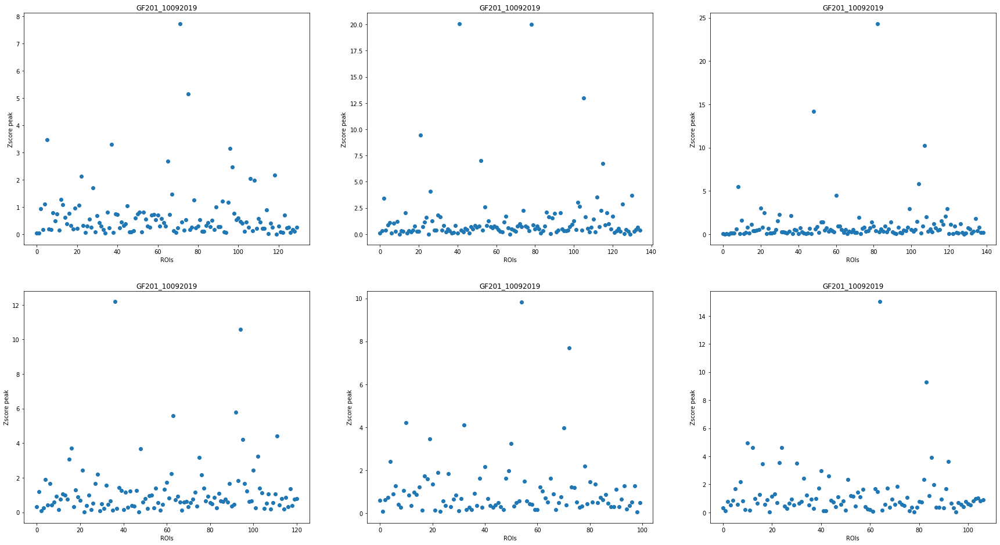

In [28]:
plt.figure(figsize=(30, 25))
for d in range(6):
    dayData = AllData[d]['WM']['WMspksbas']
    maxPoints = np.zeros([1,len(CellIndexes[d])])
    print(len(CellIndexes[d]))
    meanTrials = np.mean(dayData,axis = 2)
    for i in range(len(CellIndexes[d])):
        dataZscore = (meanTrials[CellIndexes[d][i]])
        baseline = dataZscore[55:59]
        maxPoints[0][i] = np.abs(np.mean(baseline) - np.max(dataZscore[60:65]))
        
    plt.subplot(3,3,d+1)
    plt.scatter(range(len(CellIndexes[d])),maxPoints[0][:])
    plt.title(AllData[d]['dayName'])
    plt.xlabel('ROIs')
    plt.ylabel('Zscore peak')

In [ ]:
d = 1
CR = AllData[d]['CR']['CRspks']
CRresh = np.reshape(CR,[CR.shape[0],-1])
mu = np.mean(CRresh, axis = 1)
sigma = np.std(CRresh, axis = 1)
dayData = AllData[d]['WM']['WMspks']
maxPoints = np.zeros([1,len(CellIndexes[d])])

meanTrials = np.mean(dayData,axis = 2)
meanTrials.shape


In [ ]:
plt.figure(figsize=(30, 25))
for d in range(6):
    dayData = stats.zscore(AllData[d]['WM']['WMspks'],axis =1)
    maxPoints = np.zeros([1,len(CellIndexes[d])])
    print(len(CellIndexes[d]))
    meanTrials = np.mean(dayData,axis = 2)
    for i in range(len(CellIndexes[d])):
        baseline = meanTrials[CellIndexes[d][i]][50:59]
        maxPoints[0][i] = np.abs(np.mean(baseline) - np.max(meanTrials[CellIndexes[d][i]][61:66]))
        
    plt.subplot(3,3,d+1)
    plt.scatter(range(len(CellIndexes[d])),maxPoints[0][:])
    plt.title(AllData[d]['dayName'])
    plt.xlabel('ROIs')
    plt.ylabel('Zscore peak')

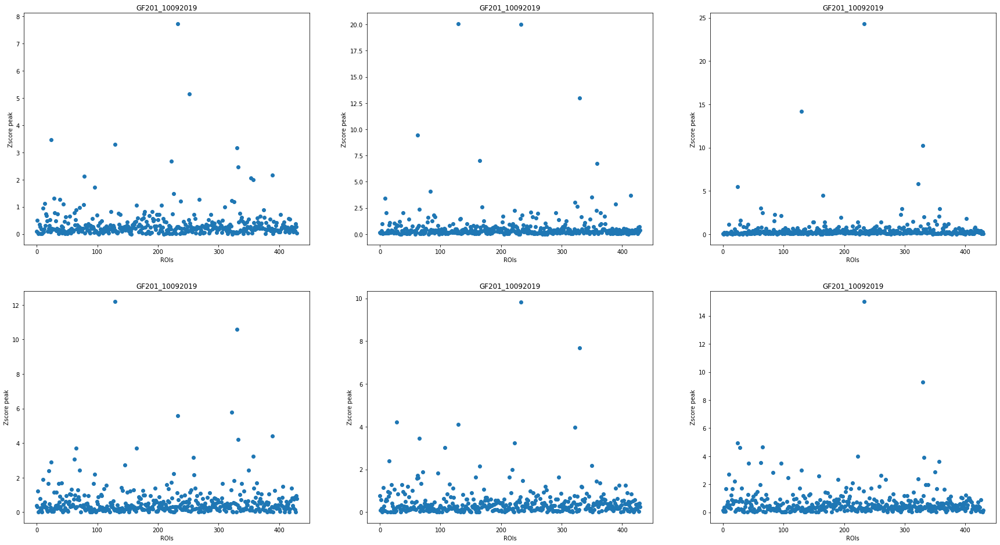

In [18]:
plt.figure(figsize=(30, 25))
for d in range(6):
    dayData = AllData[d]['WM']['WMspksbas']
    maxPoints = np.zeros([1,dayData.shape[0]])
    meanTrials = np.mean(dayData,axis = 2)
    for i in range(meanTrials.shape[0]):
        baseline = meanTrials[i][55:59]
        maxPoints[0][i] = np.abs(np.mean(baseline) - np.max(meanTrials[i][60:65]))
        
    plt.subplot(3,3,d+1)
    plt.scatter(range(meanTrials.shape[0]),maxPoints[0][:])
    plt.title(AllData[d]['dayName'])
    plt.xlabel('ROIs')
    plt.ylabel('Zscore peak')

In [ ]:
plt.scatter(range(Test2.shape[0]),maxPoints[0][:])

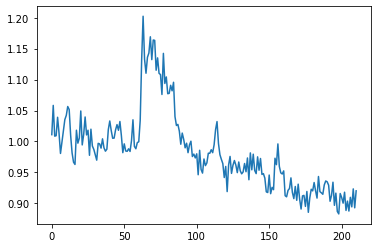

In [22]:
plt.plot(np.mean(AllData[i]['WH']['WHFbas'],axis = (0,2))[:])

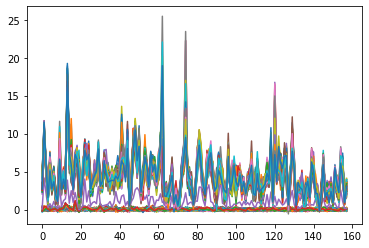

In [50]:
plt.plot(np.mean(AllData[3]['CR']['CRDFF'],axis = (2))[:])

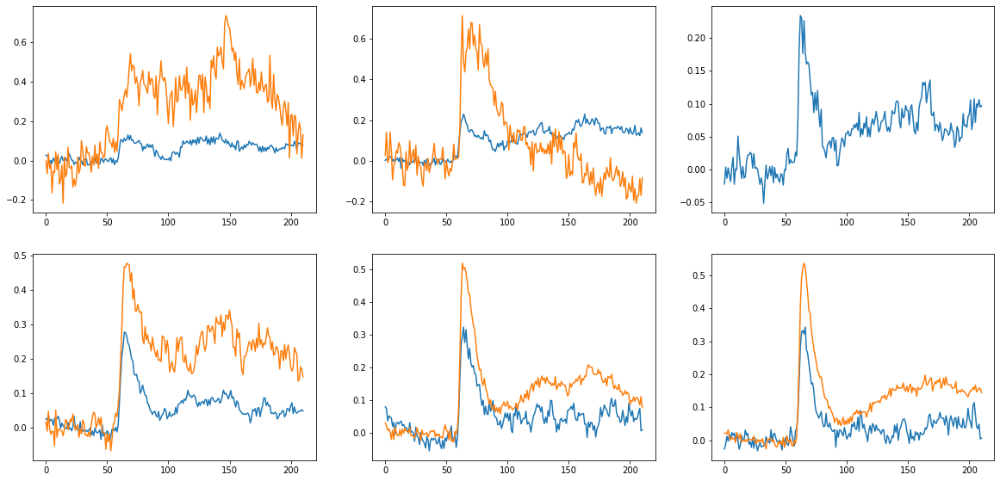

In [39]:
plt.figure(figsize=(20, 15))
for i in range(6):
    plt.subplot(3,3,i+1)
    plt.plot(np.mean(AllData[i]['WM']['WMDFF'],axis = (0,2))[:])
    plt.plot(np.mean(AllData[i]['WH']['WHDFF'],axis = (0,2))[:])
    #plt.plot(np.mean(AllData[i]['WH']['WHDFF'],axis = (0,2))[:]-np.mean(AllData[i]['CR']['CRDFF'],axis = (0,2))[:])

C:\Users\foustouk\.conda\envs\suite2p\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<Figure size 1440x1080 with 0 Axes>

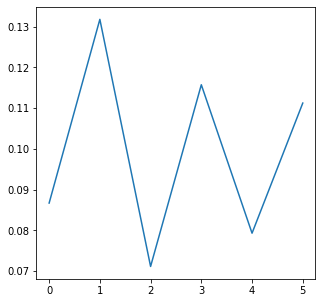

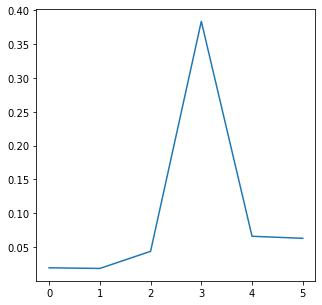

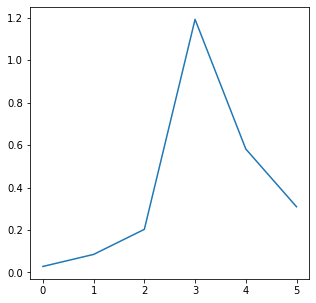

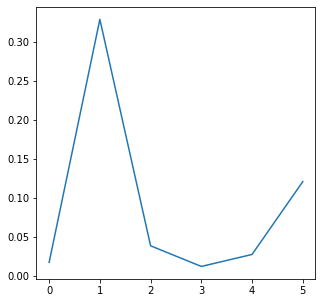

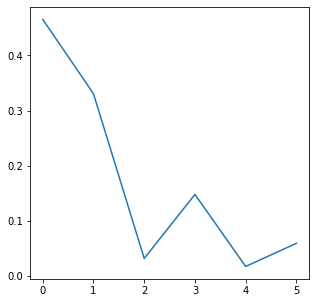

...

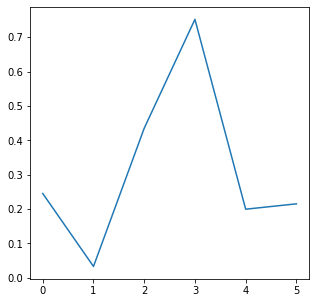

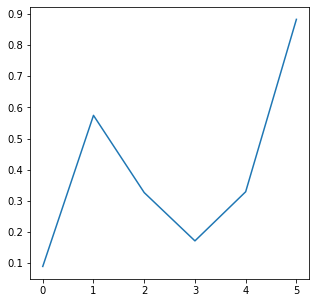

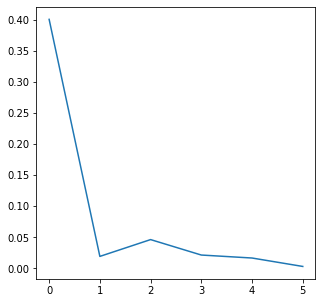

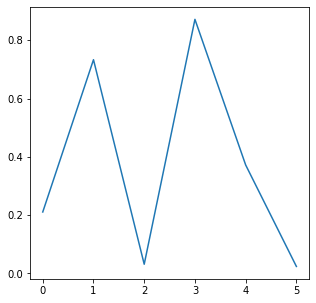

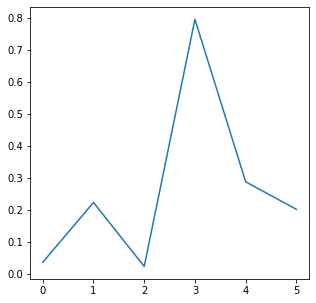

In [12]:
plt.figure(figsize=(20, 15))
for i in range(430):
    plt.figure(figsize=(5, 5))
    plt.plot(maxPoints[:,i])

In [16]:

name = 'GF207'
    
print('Calculating mouse: ' + name )

mouseName = name
nframes = 211

# Hardcoded paths to the server
datapath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\DataAll\\' + mouseName + "\\" 
readingpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\' + mouseName + "\\" 
serverpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\data\\' + mouseName + '\\Recordings\\Imaging\\'
behavpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\data\\' + mouseName + '\\Recordings\\BehaviourFiles\\'

# Detect the operating system to fix the slashes

if (os.name == "posix"):
    print("Linux or MacOS system detected")

#Play with the names only important for MacOS

    datapath= datapath.replace('\\','/')
    datapath = '/Volumes/' + datapath[18:] 
    behavpath = behavpath.replace('\\','/')
    behavpath = '/Volumes' + behavpath[18:] 
    serverpath = serverpath.replace('\\','/')
    serverpath = '/Volumes' + serverpath[18:] 

else:
    print("Windows system detected")

# Find the imaging days
imaging_days = glob.glob(os.path.join(behavpath, "GF*"))

for n,f in enumerate(imaging_days):
    imaging_days[n] = os.path.basename(f)

# Sort the imaging days by year and month in case the order is not correct
year = []
month = []
for i,f in enumerate(imaging_days):
    year.append(f[-4:])
    month.append(f[-6:-4])

yearZip = []
yearZip = natsorted(list(zip(year,imaging_days)))
year_sorted = [x for y, x in yearZip]


year = []
month = []
for i,f in enumerate(year_sorted):
    year.append(f[-4:])
    month.append(f[-6:-4])


monthZip = []
monthZip = natsorted(list(zip(month,year_sorted)))
month_sorted = [x for y, x in monthZip]


imaging_days = natsorted(month_sorted)



Calculating mouse: GF207
Windows system detected


In [15]:
datapath = Path('\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\RawDataAll\\' + name + '\\')

imaging_days = glob.glob(os.path.join(datapath, "GF*"))

for n,f in enumerate(imaging_days):
    imaging_days[n] = os.path.basename(f)


natsorted(imaging_days[1::100])

['GF207_187um_920nm_1x_01102019_00006.tif',
 'GF207_187um_920nm_1x_01102019_00108.tif',
 'GF207_187um_920nm_1x_01102019_00208.tif',
 'GF207_187um_920nm_1x_01102019_00308.tif',
 'GF207_187um_920nm_1x_01102019_00417.tif',
 'GF207_187um_920nm_1x_02102019_00002.tif',
 'GF207_187um_920nm_1x_02102019_00025.tif',
 'GF207_187um_920nm_1x_02102019_00126.tif',
 'GF207_187um_920nm_1x_02102019_00225.tif',
 'GF207_187um_920nm_1x_03102019_2_00102.tif',
 'GF207_187um_920nm_1x_03102019_2_00201.tif',
 'GF207_187um_920nm_1x_03102019_2_00302.tif',
 'GF207_187um_920nm_1x_03102019_2_00402.tif',
 'GF207_187um_920nm_1x_04102019_00037.tif',
 'GF207_187um_920nm_1x_04102019_00137.tif',
 'GF207_187um_920nm_1x_04102019_00237.tif',
 'GF207_187um_920nm_1x_04102019_00337.tif',
 'GF207_187um_920nm_1x_04102019_00437.tif',
 'GF207_187um_920nm_1x_29092019_00011.tif',
 'GF207_187um_920nm_1x_29092019_00110.tif',
 'GF207_187um_920nm_1x_29092019_00212.tif',
 'GF207_187um_920nm_1x_29092019_00312.tif',
 'GF207_187um_920nm_1x_3

In [20]:
imaging_days_cor = [imaging_days[0], imaging_days[1], imaging_days[3], imaging_days[5], imaging_days[6],imaging_days[7]] 

In [22]:
imaging_days = imaging_days_cor

In [23]:
imaging_days

['GF207_01102019',
 'GF207_02102019',
 'GF207_03102019',
 'GF207_04102019',
 'GF207_29092019',
 'GF207_30092019']

In [26]:
Order = [4,5,0,1,2,3]

for i, order in enumerate(Order):
        
        print(str(order))
        


4
5
0
1
2
3
